# AML-2103 - Visualization for AI and ML

- Abhijit Morye 	- ID C0825094
- Bruno Milhomem 	- ID C0796309
- Tashi Paljor 	    - ID C0825364

### Context
Even though much research has been conducted in the past on factors influencing life expectancy, including demographic characteristics, income composition, and death rates. It was discovered that the impact of vaccination on the human development index had not previously been considered.

### Content
The World Health Organization's (WHO) and Global Health Observatory's (GHO) data repositories maintain track of each country's health status as well as a variety of other parameters.

The data sets are made accessible for the sake of analysing health data. Data on life expectancy and health variables for 193 nations was gathered from the same WHO data repository website, while economic data was gathered from the United Nations website.

From all of the categories of health-related factors, only the most representative critical elements were selected. It has been noted that there has been significant progress in the health sector during the last 15 years, resulting in lower human mortality rates, particularly in developing countries.

###  Project - Life Expectancy Prediction in Different Countries.

The project is divided into 5 steps.

- Step 1.	Dataset gathering
- Step 2.	Dataset cleaning
- Step 3.	Exploratory Data Analysis (EDA)
- Step 4.   Model Build
- Step 5.	Reporting and result presentation


# Step 1.   Dataset gathering

In [129]:
!pip install -U kaleido

In [1]:
# Importing the needed packages

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go

In [2]:
# Load Dataset

file = 'file/Life Expectancy Data.csv'

df = pd.read_csv(file)
df.head(11).T

,0,1,2,3,4,5,6,7,8,9,10
Country,Afghanistan,Afghanistan,Afghanistan,Afghanistan,Afghanistan,Afghanistan,Afghanistan,Afghanistan,Afghanistan,Afghanistan,Afghanistan
Year,2015,2014,2013,2012,2011,2010,2009,2008,2007,2006,2005
Status,Developing,Developing,Developing,Developing,Developing,Developing,Developing,Developing,Developing,Developing,Developing
Life expectancy,65,59.9,59.9,59.5,59.2,58.8,58.6,58.1,57.5,57.3,57.3
Adult Mortality,263,271,268,272,275,279,281,287,295,295,291
infant deaths,62,64,66,69,71,74,77,80,82,84,85
Alcohol,0.01,0.01,0.01,0.01,0.01,0.01,0.01,0.03,0.02,0.03,0.02
percentage expenditure,71.2796,73.5236,73.2192,78.1842,7.09711,79.6794,56.7622,25.8739,10.9102,17.1715,1.38865
Hepatitis B,65,62,64,67,68,66,63,64,63,64,66
Measles,1154,492,430,2787,3013,1989,2861,1599,1141,1990,1296


In [3]:
# Dimensions of the dataframe

df.shape

(2938, 22)

In [4]:
# Size of the dataframe

df.size

64636

In [5]:
# Describing the dataset

df.describe().T

,count,mean,std,min,25%,50%,75%,max
Year,2938.0,2.007519e+03,4.613841e+00,2000.00000,2004.000000,2.008000e+03,2.012000e+03,2.015000e+03
Life expectancy,2928.0,6.922493e+01,9.523867e+00,36.30000,63.100000,7.210000e+01,7.570000e+01,8.900000e+01
Adult Mortality,2928.0,1.647964e+02,1.242921e+02,1.00000,74.000000,1.440000e+02,2.280000e+02,7.230000e+02
infant deaths,2938.0,3.030395e+01,1.179265e+02,0.00000,0.000000,3.000000e+00,2.200000e+01,1.800000e+03
Alcohol,2744.0,4.602861e+00,4.052413e+00,0.01000,0.877500,3.755000e+00,7.702500e+00,1.787000e+01
percentage expenditure,2938.0,7.382513e+02,1.987915e+03,0.00000,4.685343,6.491291e+01,4.415341e+02,1.947991e+04
Hepatitis B,2385.0,8.094046e+01,2.507002e+01,1.00000,77.000000,9.200000e+01,9.700000e+01,9.900000e+01
Measles,2938.0,2.419592e+03,1.146727e+04,0.00000,0.000000,1.700000e+01,3.602500e+02,2.121830e+05
BMI,2904.0,3.832125e+01,2.004403e+01,1.00000,19.300000,4.350000e+01,5.620000e+01,8.730000e+01
under-five deaths,2938.0,4.203574e+01,1.604455e+02,0.00000,0.000000,4.000000e+00,2.800000e+01,2.500000e+03


In [6]:
# Info from the dataset

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2938 entries, 0 to 2937
Data columns (total 22 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Country                          2938 non-null   object 
 1   Year                             2938 non-null   int64  
 2   Status                           2938 non-null   object 
 3   Life expectancy                  2928 non-null   float64
 4   Adult Mortality                  2928 non-null   float64
 5   infant deaths                    2938 non-null   int64  
 6   Alcohol                          2744 non-null   float64
 7   percentage expenditure           2938 non-null   float64
 8   Hepatitis B                      2385 non-null   float64
 9   Measles                          2938 non-null   int64  
 10   BMI                             2904 non-null   float64
 11  under-five deaths                2938 non-null   int64  
 12  Polio               

# Step 2.	Dataset cleaning

In [7]:
# Checking duplicated

df.duplicated().sum()

0

In [8]:
# Checking if there are null/missing values in the dataset

df.isnull().sum()

Country                              0
Year                                 0
Status                               0
Life expectancy                     10
Adult Mortality                     10
infant deaths                        0
Alcohol                            194
percentage expenditure               0
Hepatitis B                        553
Measles                              0
 BMI                                34
under-five deaths                    0
Polio                               19
Total expenditure                  226
Diphtheria                          19
 HIV/AIDS                            0
GDP                                448
Population                         652
 thinness  1-19 years               34
 thinness 5-9 years                 34
Income composition of resources    167
Schooling                          163
dtype: int64

In [9]:
# All unique values

column_names = df.columns.to_list()
column_names

['Country',
 'Year',
 'Status',
 'Life expectancy ',
 'Adult Mortality',
 'infant deaths',
 'Alcohol',
 'percentage expenditure',
 'Hepatitis B',
 'Measles ',
 ' BMI ',
 'under-five deaths ',
 'Polio',
 'Total expenditure',
 'Diphtheria ',
 ' HIV/AIDS',
 'GDP',
 'Population',
 ' thinness  1-19 years',
 ' thinness 5-9 years',
 'Income composition of resources',
 'Schooling']

In [10]:
# Removing spaces beteween the column names as we have in some columns as showed above

def trim_all_columns(df):
    """
    Trim whitespace from ends of each value across all series in dataframe
    """
    column_list = df.columns.tolist()
    trim_columns =  []
    for col in column_list:
        col = col.strip()
        trim_columns.append(col)

    df.columns = trim_columns
    return df

In [11]:
trim_df = trim_all_columns(df)
trim_df.columns.to_list()
df = trim_df
df.head().T

,0,1,2,3,4
Country,Afghanistan,Afghanistan,Afghanistan,Afghanistan,Afghanistan
Year,2015,2014,2013,2012,2011
Status,Developing,Developing,Developing,Developing,Developing
Life expectancy,65,59.9,59.9,59.5,59.2
Adult Mortality,263,271,268,272,275
infant deaths,62,64,66,69,71
Alcohol,0.01,0.01,0.01,0.01,0.01
percentage expenditure,71.2796,73.5236,73.2192,78.1842,7.09711
Hepatitis B,65,62,64,67,68
Measles,1154,492,430,2787,3013


In [12]:
column_names = df.columns.to_list()
column_names

['Country',
 'Year',
 'Status',
 'Life expectancy',
 'Adult Mortality',
 'infant deaths',
 'Alcohol',
 'percentage expenditure',
 'Hepatitis B',
 'Measles',
 'BMI',
 'under-five deaths',
 'Polio',
 'Total expenditure',
 'Diphtheria',
 'HIV/AIDS',
 'GDP',
 'Population',
 'thinness  1-19 years',
 'thinness 5-9 years',
 'Income composition of resources',
 'Schooling']

In [13]:
for col in column_names:
    print(col)
    print(df[col].unique().tolist())
    print("="*150)

Country
['Afghanistan', 'Albania', 'Algeria', 'Angola', 'Antigua and Barbuda', 'Argentina', 'Armenia', 'Australia', 'Austria', 'Azerbaijan', 'Bahamas', 'Bahrain', 'Bangladesh', 'Barbados', 'Belarus', 'Belgium', 'Belize', 'Benin', 'Bhutan', 'Bolivia (Plurinational State of)', 'Bosnia and Herzegovina', 'Botswana', 'Brazil', 'Brunei Darussalam', 'Bulgaria', 'Burkina Faso', 'Burundi', "Côte d'Ivoire", 'Cabo Verde', 'Cambodia', 'Cameroon', 'Canada', 'Central African Republic', 'Chad', 'Chile', 'China', 'Colombia', 'Comoros', 'Congo', 'Cook Islands', 'Costa Rica', 'Croatia', 'Cuba', 'Cyprus', 'Czechia', "Democratic People's Republic of Korea", 'Democratic Republic of the Congo', 'Denmark', 'Djibouti', 'Dominica', 'Dominican Republic', 'Ecuador', 'Egypt', 'El Salvador', 'Equatorial Guinea', 'Eritrea', 'Estonia', 'Ethiopia', 'Fiji', 'Finland', 'France', 'Gabon', 'Gambia', 'Georgia', 'Germany', 'Ghana', 'Greece', 'Grenada', 'Guatemala', 'Guinea', 'Guinea-Bissau', 'Guyana', 'Haiti', 'Honduras', 

- To handle null values, we will assign the most frequent values that is appeared in our dataset fot the following columns.

  - GDP -> Gross Domestic Product
  - Population
  - Hepatitis B
  - Alcohol
  - Income composition of resources
  - Schooling
  - Total expenditure
  - Life expectancy
  - Adult Mortality
  - BMI -> Body Mass Index
  - Polio
  - Diphtheria
  - Thinness 1-19 Years
  - Thinnesss 5-9 Years

In [14]:
from sklearn.impute import SimpleImputer
# Reference: https://scikit-learn.org/stable/modules/generated/sklearn.impute.SimpleImputer.html

simple_imputer = SimpleImputer(strategy='most_frequent', missing_values=np.NaN)

df['GDP'] = simple_imputer.fit_transform(df['GDP'].values.reshape(-1,1))
df['Population'] = simple_imputer.fit_transform(df['Population'].values.reshape(-1,1))
df['Hepatitis B'] = simple_imputer.fit_transform(df['Hepatitis B'].values.reshape(-1,1))
df['Alcohol'] = simple_imputer.fit_transform(df['Alcohol'].values.reshape(-1,1))
df['Income composition of resources'] = simple_imputer.fit_transform(df['Income composition of resources'].values.reshape(-1,1))
df['Schooling'] = simple_imputer.fit_transform(df['Schooling'].values.reshape(-1,1))
df['Total expenditure'] = simple_imputer.fit_transform(df['Total expenditure'].values.reshape(-1,1))
df['Life expectancy'] = simple_imputer.fit_transform(df['Life expectancy'].values.reshape(-1,1))
df['Adult Mortality'] = simple_imputer.fit_transform(df['Adult Mortality'].values.reshape(-1,1))
df['BMI'] = simple_imputer.fit_transform(df['BMI'].values.reshape(-1,1))
df['Polio'] = simple_imputer.fit_transform(df['Polio'].values.reshape(-1,1))
df['Diphtheria'] = simple_imputer.fit_transform(df['Diphtheria'].values.reshape(-1,1))
df['thinness  1-19 years'] = simple_imputer.fit_transform(df['thinness  1-19 years'].values.reshape(-1,1))
df['thinness 5-9 years'] = simple_imputer.fit_transform(df['thinness 5-9 years'].values.reshape(-1,1))

In [15]:
# Renaming some column names.

df.rename(columns={"Life expectancy" : "Life_Expectancy",
                   "Adult Mortality" : "Adult_Mortality",
                   "infant deaths" : "Infant_Deaths",
                   "percentage expenditure" : "Percentage_Exp",
                   "Hepatitis B" : "Hepatitis_B",
                   "under-five deaths" : "Under_Five_Deaths",
                   "thinness  1-19 years" : "thinness_1_to_19_years",
                   "thinness 5-9 years" : "thinness_5_to_9_years",
                   "Income composition of resources" : "Income_Comp_Of_Resources",
                   "Total expenditure":"Total_Expenditure"},
                   inplace=True)

In [16]:
# Checking again if there are missing values in the dataset

df.isnull().sum()

Country                     0
Year                        0
Status                      0
Life_Expectancy             0
Adult_Mortality             0
Infant_Deaths               0
Alcohol                     0
Percentage_Exp              0
Hepatitis_B                 0
Measles                     0
BMI                         0
Under_Five_Deaths           0
Polio                       0
Total_Expenditure           0
Diphtheria                  0
HIV/AIDS                    0
GDP                         0
Population                  0
thinness_1_to_19_years      0
thinness_5_to_9_years       0
Income_Comp_Of_Resources    0
Schooling                   0
dtype: int64

As we do not have more null values, we can start performing the EDA step.

# Step 3.	Exploratory Data Analysis (EDA)

In [17]:
df.head(5)

,Country,Year,Status,Life_Expectancy,Adult_Mortality,Infant_Deaths,Alcohol,Percentage_Exp,Hepatitis_B,Measles,...,Polio,Total_Expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness_1_to_19_years,thinness_5_to_9_years,Income_Comp_Of_Resources,Schooling
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,2012,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,2011,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5


### Plotting Bar


### Distribution of each numerical variable.

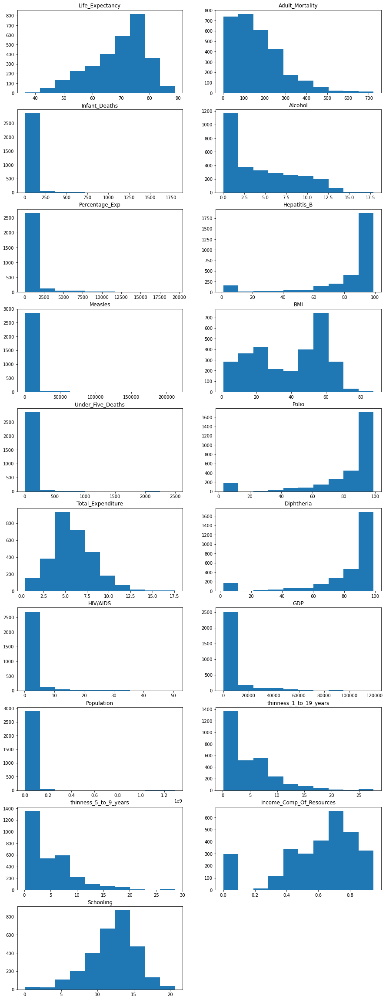

In [18]:
# Distribution of each numerical variable.
all_col = ['Life_Expectancy', 
           'Adult_Mortality', 
           'Infant_Deaths',
           'Alcohol',
           'Percentage_Exp',
           'Hepatitis_B',
           'Measles',
           'BMI',
           'Under_Five_Deaths',
           'Polio',
           'Total_Expenditure',
           'Diphtheria',
           'HIV/AIDS',
           'GDP',
           'Population',
           'thinness_1_to_19_years',
           'thinness_5_to_9_years',
           'Income_Comp_Of_Resources',
           'Schooling'
          ]

plt.figure(figsize=(15,75))

for i in range(len(all_col)):
    plt.subplot(18,2,i+1)
    plt.hist(df[all_col[i]])
    plt.title(all_col[i])

plt.show()

### Life_Expectancy vs Status using bar plot.

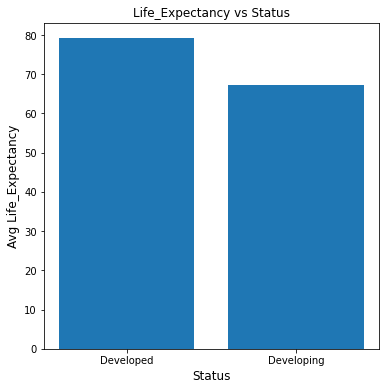

In [19]:


plt.figure(figsize=(6,6))
plt.bar(df.groupby('Status')['Status'].count().index,df.groupby('Status')['Life_Expectancy'].mean())
plt.xlabel("Status",fontsize=12)
plt.ylabel("Avg Life_Expectancy",fontsize=12)
plt.title("Life_Expectancy vs Status")
plt.show()

### Life_Expectancy vs Country using bar plot.

In [ ]:


country = df.groupby('Country')['Life_Expectancy'].mean()
country.plot(kind='bar', figsize=(50,15), fontsize=25)
plt.title("Life_Expectancy vs Country",fontsize=40)
plt.xlabel("Country",fontsize=25)
plt.ylabel("Avg Life_Expectancy",fontsize=35)
plt.show()

#### Life_Expectancy vs Year using bar plot.

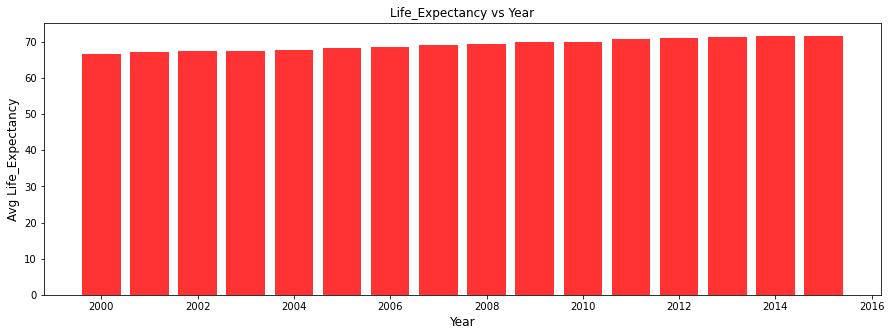

In [21]:


plt.figure(figsize=(15,5))
plt.bar(df.groupby('Year')['Year'].count().index,df.groupby('Year')['Life_Expectancy'].mean(),color='red',alpha=0.80)
plt.xlabel("Year",fontsize=12)
plt.ylabel("Avg Life_Expectancy", fontsize=12)
plt.title("Life_Expectancy vs Year")
plt.show()

### Distribution of country status in the dataset

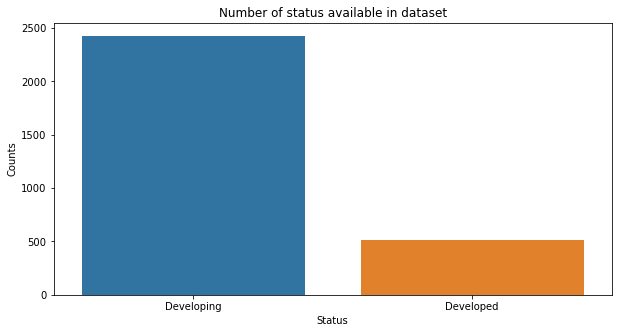

In [22]:

plt.figure(figsize=(10,5))
sns.countplot(x='Status', data=df)
plt.xlabel('Status')
plt.ylabel('Counts')
plt.title('Number of status available in dataset')
plt.show()

### Distribution of country status in the dataset

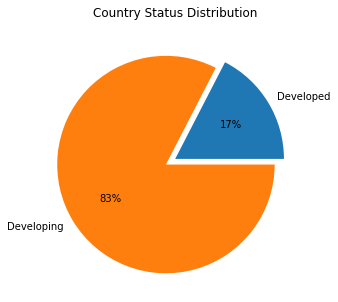

In [23]:

df_country_status_count = df.groupby('Status')['Year'].count().reset_index().rename(columns={'Year': 'Count'})

plt.figure(figsize=(10,5))
explode = [0, 0.1]
plt.pie(df_country_status_count['Count'], labels=df_country_status_count['Status'], autopct='%.0f%%', explode=explode)
plt.title('Country Status Distribution')
plt.show()

### Scatter plot between the target variable(Life_Expectancy) and all continuous variables.

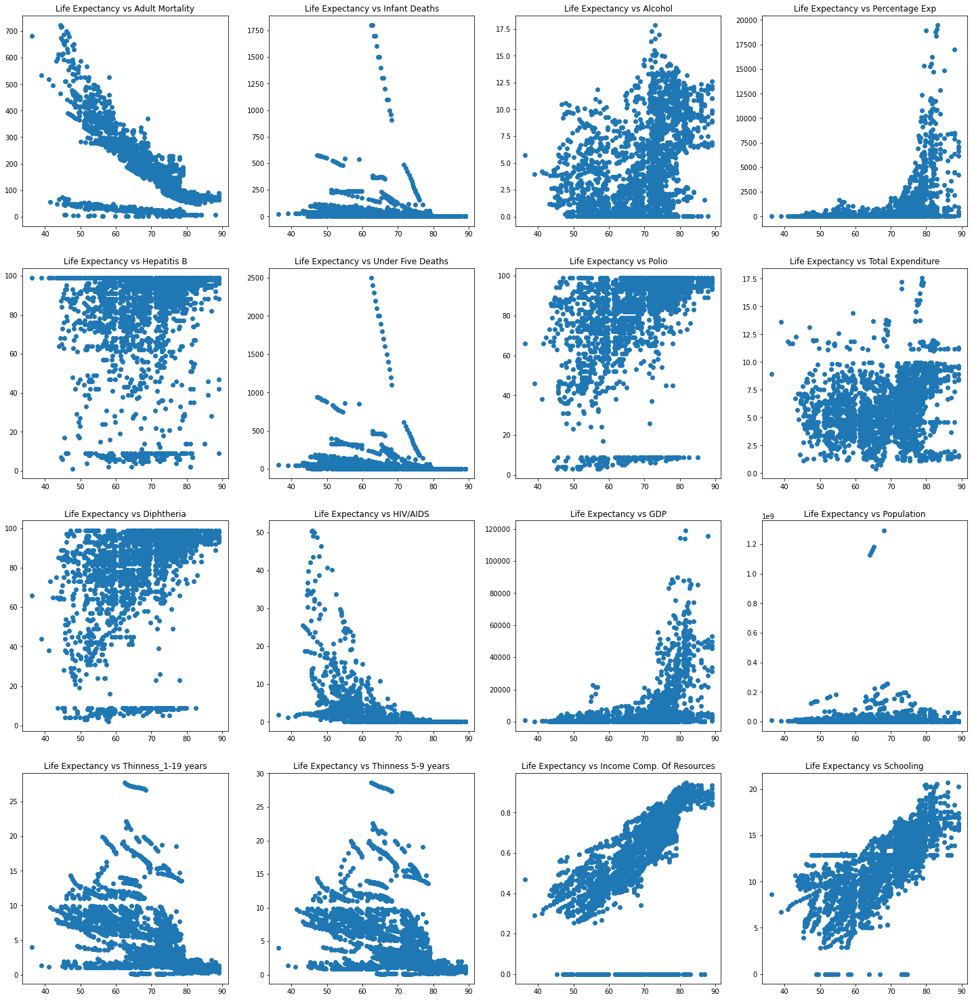

In [24]:
plt.figure(figsize=(25,40))

plt.subplot(6,4,1)
plt.scatter(df["Life_Expectancy"], df["Adult_Mortality"])
plt.title("Life Expectancy vs Adult Mortality")



plt.subplot(6,4,2)
plt.scatter(df["Life_Expectancy"], df["Infant_Deaths"])
plt.title("Life Expectancy vs Infant Deaths")



plt.subplot(6,4,3)
plt.scatter(df["Life_Expectancy"], df["Alcohol"])
plt.title("Life Expectancy vs Alcohol")



plt.subplot(6,4,4)
plt.scatter(df["Life_Expectancy"], df["Percentage_Exp"])
plt.title("Life Expectancy vs Percentage Exp")



plt.subplot(6,4,5)
plt.scatter(df["Life_Expectancy"], df["Hepatitis_B"])
plt.title("Life Expectancy vs Hepatitis B")



plt.subplot(6,4,6)
plt.scatter(df["Life_Expectancy"], df["Under_Five_Deaths"])
plt.title("Life Expectancy vs Under Five Deaths")



plt.subplot(6,4,7)
plt.scatter(df["Life_Expectancy"], df["Polio"])
plt.title("Life Expectancy vs Polio")



plt.subplot(6,4,8)
plt.scatter(df["Life_Expectancy"], df["Total_Expenditure"])
plt.title("Life Expectancy vs Total Expenditure")



plt.subplot(6,4,9)
plt.scatter(df["Life_Expectancy"], df["Diphtheria"])
plt.title("Life Expectancy vs Diphtheria")



plt.subplot(6,4,10)
plt.scatter(df["Life_Expectancy"], df["HIV/AIDS"])
plt.title("Life Expectancy vs HIV/AIDS")



plt.subplot(6,4,11)
plt.scatter(df["Life_Expectancy"], df["GDP"])
plt.title("Life Expectancy vs GDP")



plt.subplot(6,4,12)
plt.scatter(df["Life_Expectancy"], df["Population"])
plt.title("Life Expectancy vs Population")



plt.subplot(6,4,13)
plt.scatter(df["Life_Expectancy"], df["thinness_1_to_19_years"])
plt.title("Life Expectancy vs Thinness_1-19 years")



plt.subplot(6,4,14)
plt.scatter(df["Life_Expectancy"], df["thinness_5_to_9_years"])
plt.title("Life Expectancy vs Thinness 5-9 years")



plt.subplot(6,4,15)
plt.scatter(df["Life_Expectancy"], df["Income_Comp_Of_Resources"])
plt.title("Life Expectancy vs Income Comp. Of Resources")


plt.subplot(6,4,16)
plt.scatter(df["Life_Expectancy"], df["Schooling"])
plt.title("Life Expectancy vs Schooling")
plt.show()

### Seaborn

#### Relplot

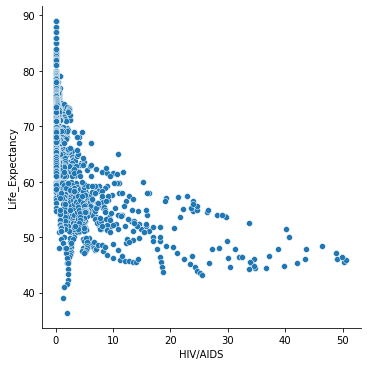

In [25]:
# Life Expectancy vs HIV/AIDS using relplot
sns.relplot(x='HIV/AIDS', y='Life_Expectancy', data=df)
plt.show()

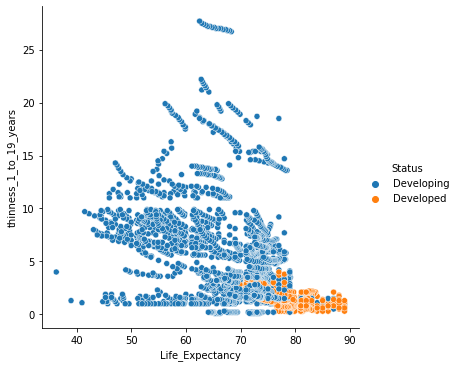

In [26]:
# Life Expectancy vs Thinness 1-19 Years per Status using relplot
sns.relplot(x='Life_Expectancy', y='thinness_1_to_19_years', data=df, hue='Status')
plt.show()

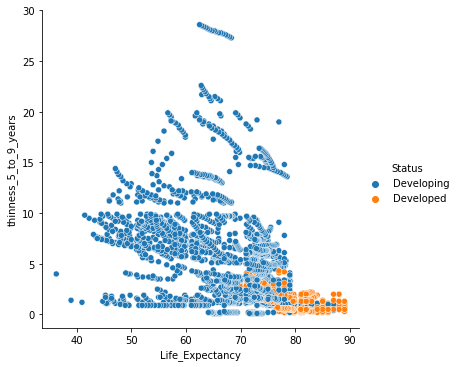

In [27]:
# Life Expectancy vs Thinness 1-19 Years per Status using relplot
sns.relplot(x='Life_Expectancy', y='thinness_5_to_9_years', data=df, hue='Status')
plt.show()

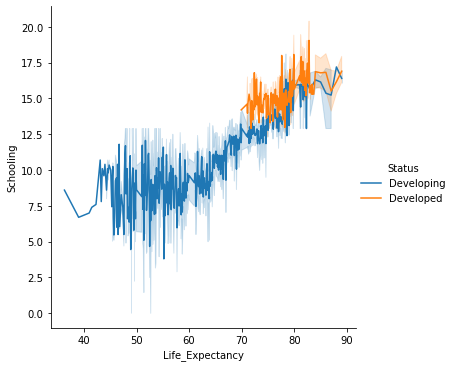

In [28]:
# Life Expectancy vs Schooling per Status using relplot
sns.relplot(data=df, x='Life_Expectancy', y='Schooling', hue='Status', kind='line')
plt.show()

### Life Expectancy vs GDP per Year using relplot

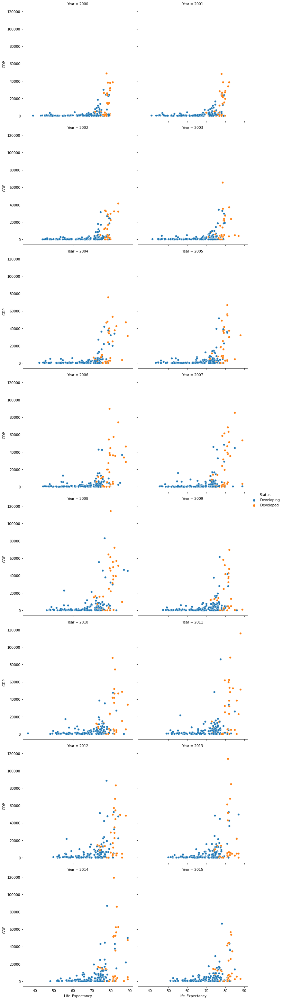

In [29]:

sns.relplot(data=df, x='Life_Expectancy', y='GDP', hue='Status', col='Year', col_wrap=2)
plt.show()

### Life Expectancy vs BMI per Year using relplot

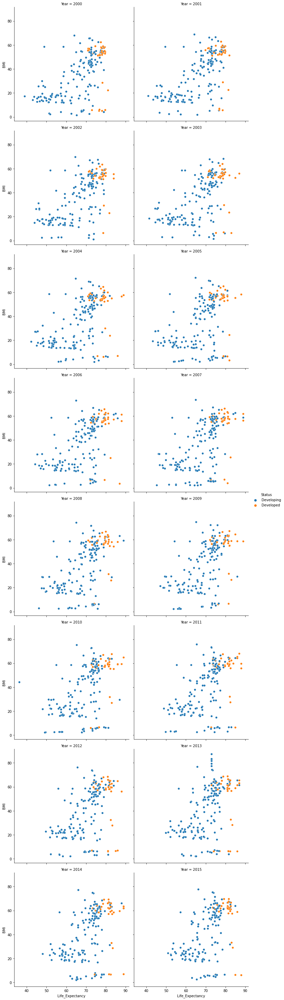

In [30]:

sns.relplot(data=df, x='Life_Expectancy', y='BMI', hue='Status', col='Year', col_wrap=2)
plt.show()

#### Lmplot

### Life Expectancy vs Alcohol using lmplot

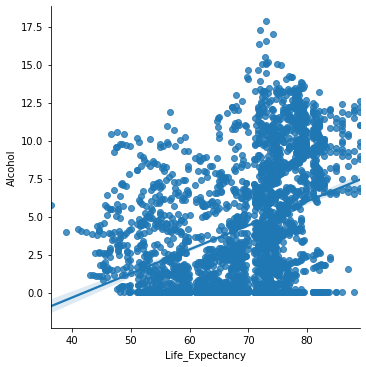

In [31]:

sns.lmplot(x='Life_Expectancy', y='Alcohol', data=df)
plt.show()

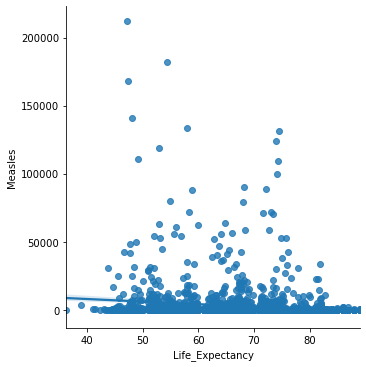

In [32]:
# Life Expectancy vs Measles using lmplot
sns.lmplot(x='Life_Expectancy', y='Measles', data=df)
plt.show()

#### Regplot

### Life Expectancy vs GDP using regplot

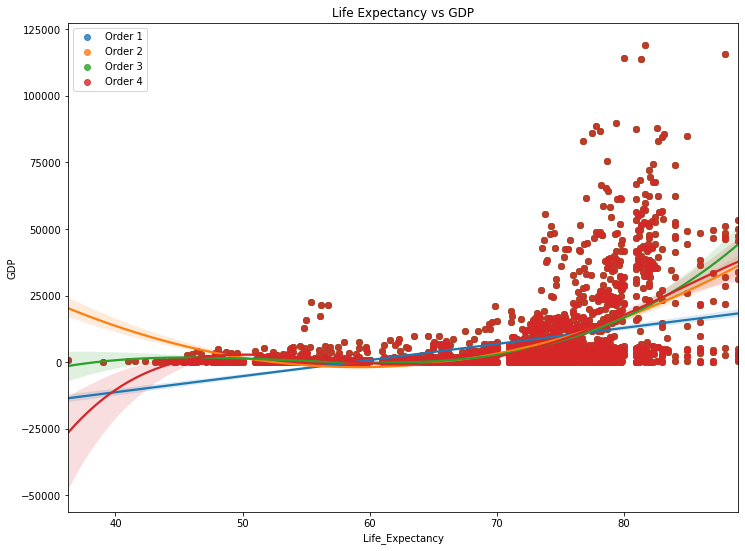

In [33]:

plt.figure(figsize=(12, 9))
sns.regplot(x='Life_Expectancy', y='GDP', data=df, order=1, label='Order 1')
sns.regplot(x='Life_Expectancy', y='GDP', data=df, order=2 , label='Order 2')
sns.regplot(x='Life_Expectancy', y='GDP', data=df, order=3, label='Order 3')
sns.regplot(x='Life_Expectancy', y='GDP', data=df, order=4, label='Order 4')
plt.title('Life Expectancy vs GDP')

plt.legend()
plt.show()

### Life Expectancy vs BMI using regplot

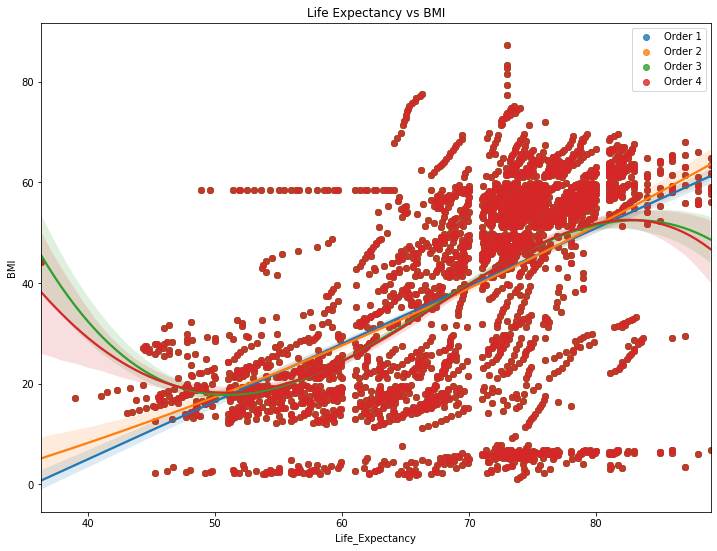

In [34]:

plt.figure(figsize=(12, 9))
sns.regplot(x='Life_Expectancy', y='BMI', data=df, order=1, label='Order 1')
sns.regplot(x='Life_Expectancy', y='BMI', data=df, order=2 , label='Order 2')
sns.regplot(x='Life_Expectancy', y='BMI', data=df, order=3, label='Order 3')
sns.regplot(x='Life_Expectancy', y='BMI', data=df, order=4, label='Order 4')
plt.title('Life Expectancy vs BMI')

plt.legend()
plt.show()

### Life Expectancy vs Polio using regplot

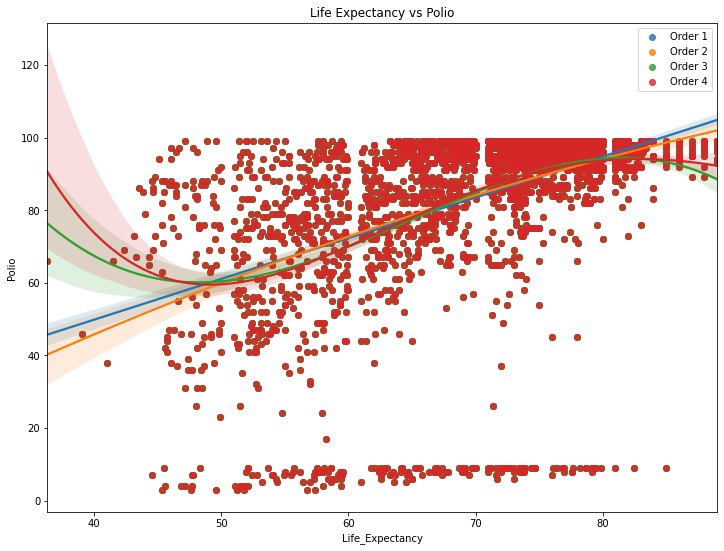

In [35]:

plt.figure(figsize=(12, 9))
sns.regplot(x='Life_Expectancy', y='Polio', data=df, order=1, label='Order 1')
sns.regplot(x='Life_Expectancy', y='Polio', data=df, order=2 , label='Order 2')
sns.regplot(x='Life_Expectancy', y='Polio', data=df, order=3, label='Order 3')
sns.regplot(x='Life_Expectancy', y='Polio', data=df, order=4, label='Order 4')
plt.title('Life Expectancy vs Polio')

plt.legend()
plt.show()

### Life Expectancy vs Diphtheria using regplot

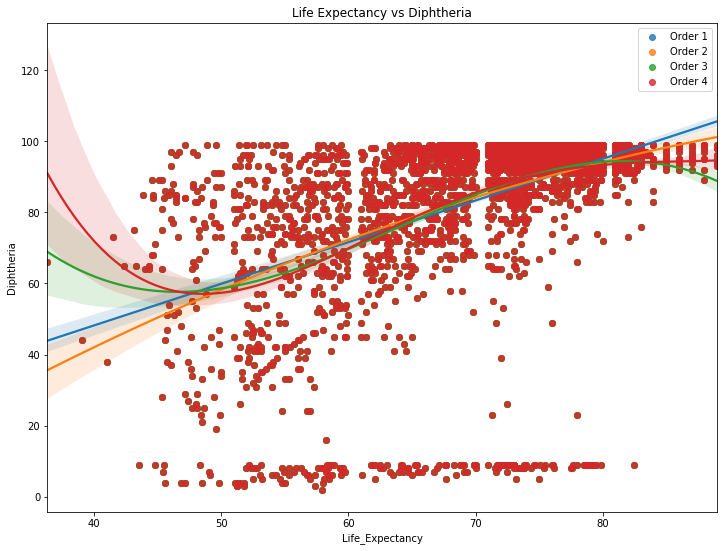

In [36]:

plt.figure(figsize=(12, 9))
sns.regplot(x='Life_Expectancy', y='Diphtheria', data=df, order=1, label='Order 1')
sns.regplot(x='Life_Expectancy', y='Diphtheria', data=df, order=2 , label='Order 2')
sns.regplot(x='Life_Expectancy', y='Diphtheria', data=df, order=3, label='Order 3')
sns.regplot(x='Life_Expectancy', y='Diphtheria', data=df, order=4, label='Order 4')
plt.title('Life Expectancy vs Diphtheria')

plt.legend()
plt.show()

#### Box plot

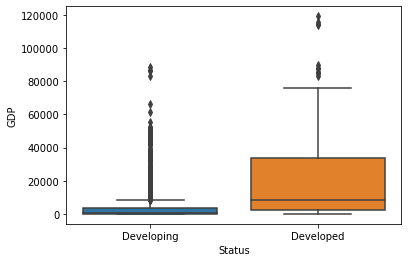

In [37]:
# Status vs GDP using boxplot
sns.boxplot(x='Status', y='GDP', data=df)
plt.show()

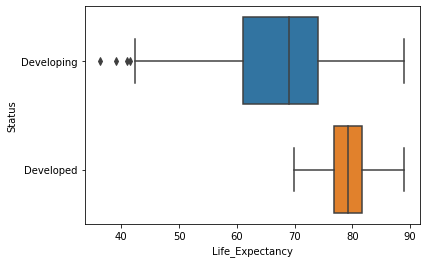

In [38]:
# Life Expectancy vs Status using boxplot
sns.boxplot(x='Life_Expectancy', y='Status', data=df)
plt.show()

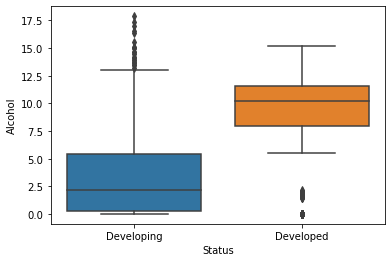

In [39]:
# Status vs Alcohol using boxplot
sns.boxplot(x='Status', y='Alcohol', data=df)
plt.show()

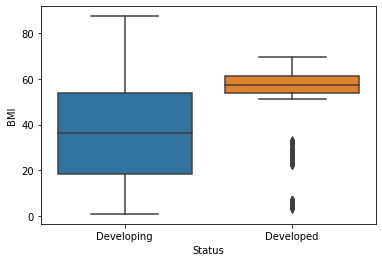

In [40]:
# Status vs BMI using boxplot
sns.boxplot(x='Status', y='BMI', data=df)
plt.show()

#### Pairplot

<Figure size 1080x360 with 0 Axes>

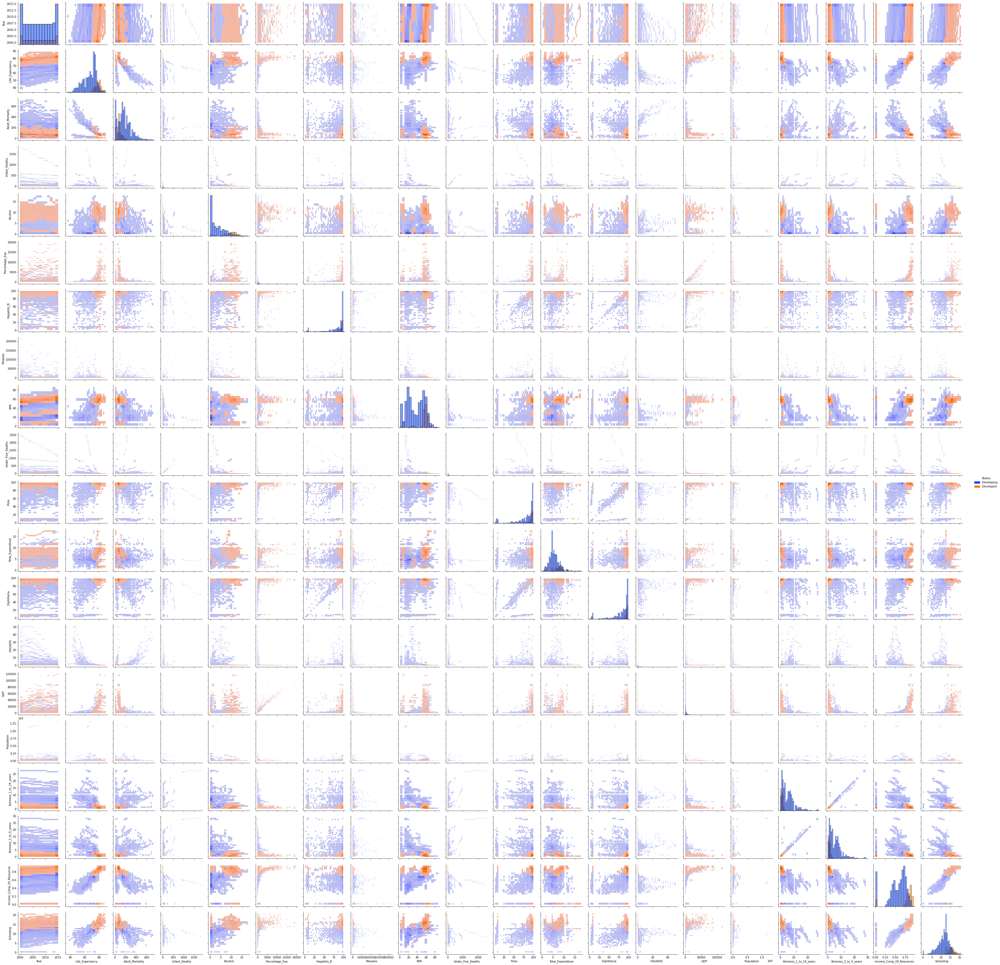

In [41]:
plt.figure(figsize=(15,5))
sns.pairplot(df, kind='hist', hue='Status', palette='bright')
plt.show()

#### Heatmap

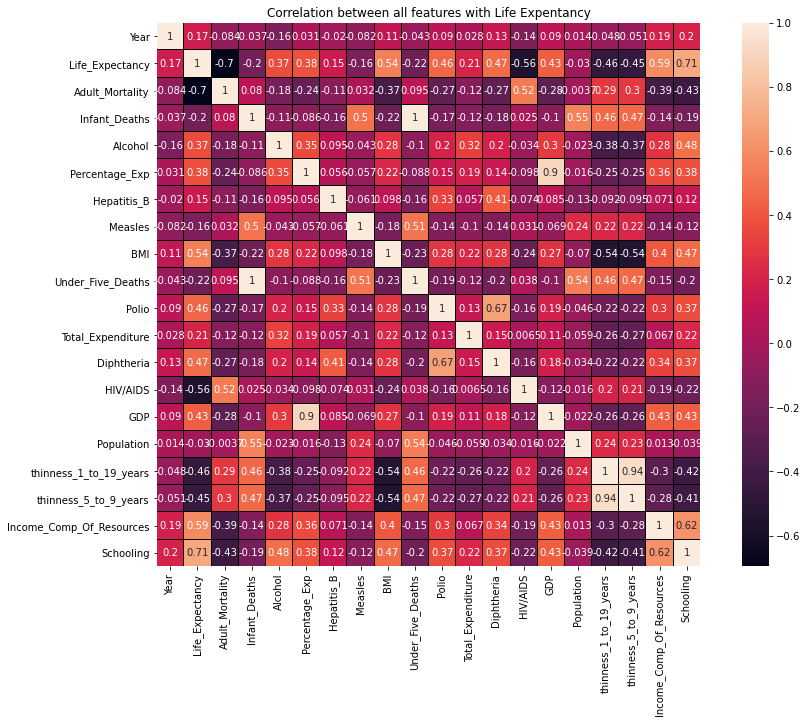

In [42]:
# Correlation of the Dataset using Heatmap
plt.figure(figsize=(15, 10))
sns.heatmap(df.corr(), square=True, linecolor='black', linewidths=0.05, annot=True)
plt.title('Correlation between all features with Life Expentancy')
plt.show()

#### Joint Plot

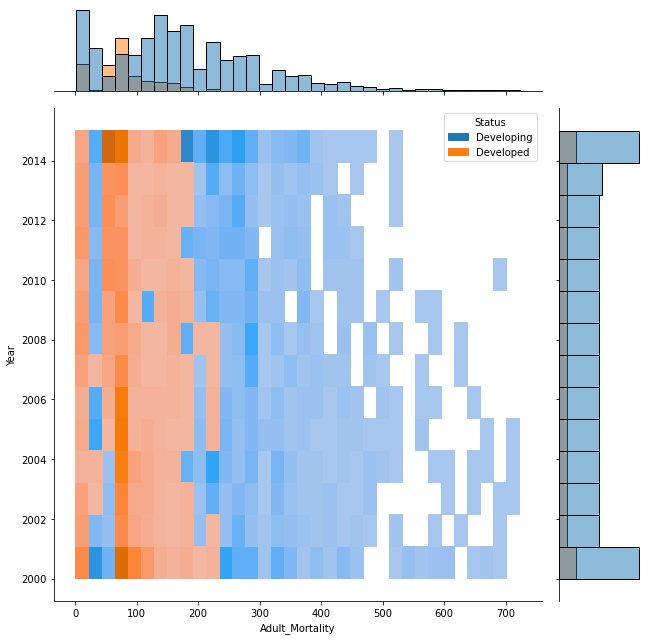

In [43]:
# Adult Mortality vs Year per Status
sns.jointplot(x='Adult_Mortality', y='Year', data=df, hue='Status', kind='hist', height=9)
plt.show()

#### FacetGrid

### Distribution of features as per country wise in the dataset

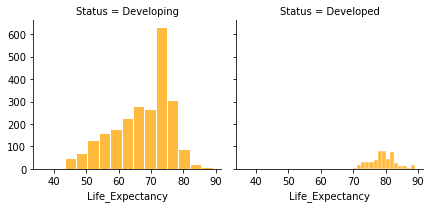

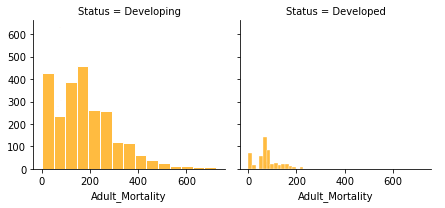

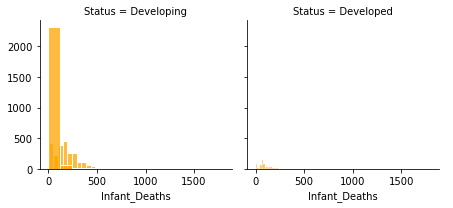

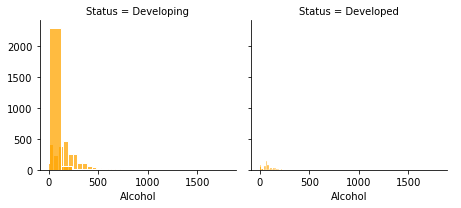

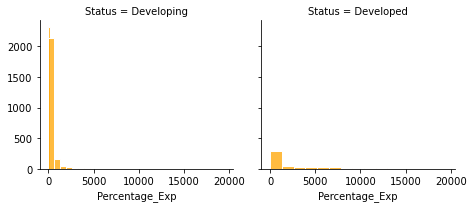

...

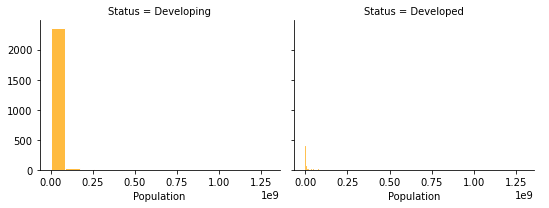

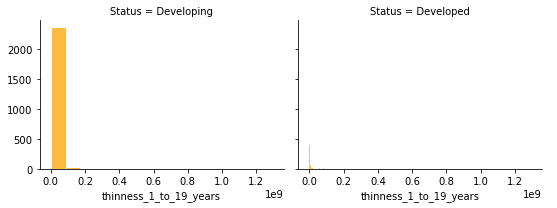

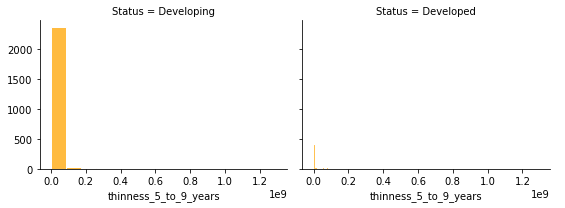

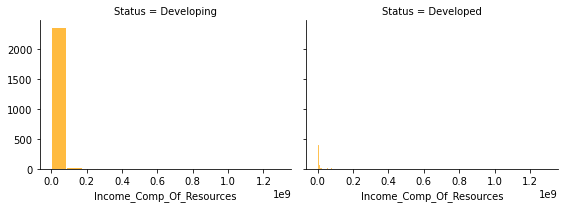

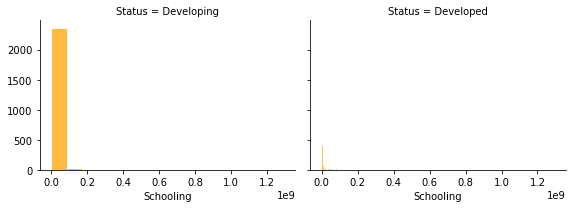

<Figure size 432x288 with 0 Axes>

In [199]:


distribution_columns = [x for x in df.columns.to_list() if x not in ['Country', 'Year', 'Status']]

graph = sns.FacetGrid(df, col='Status')
for col in distribution_columns:
    graph.map(sns.histplot, col, edgecolor ="w", bins = 15, color='orange').add_legend()
    plt.show()
    

### Change in Life Expentency over the years according to country wise

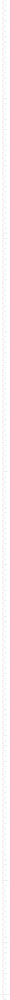

<Figure size 432x288 with 0 Axes>

In [201]:
graph = sns.FacetGrid(df, row='Country')
graph.map(plt.plot, 'Year', 'Life_Expectancy')
plt.title('Change in Life Expentency over the years according to country wise')
plt.show()
plt.savefig('Change_in_Life_Expentency_over_the_years_according_to_country_wise.png')

### Change in infant deaths over the years according to country wise

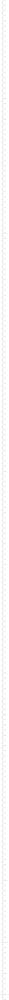

In [46]:
graph = sns.FacetGrid(df, row='Country')
graph.map(plt.plot, 'Year', 'Infant_Deaths')
plt.title('Change in infant deaths over the years according to country wise')
plt.show()

### Change in Alcohol consumption over the years according to country wise

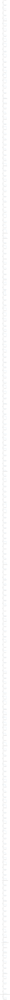

In [47]:

graph = sns.FacetGrid(df, row='Country')
graph.map(plt.plot, 'Year', 'Alcohol')
plt.title('Change in alcohol consumption over the years according to country wise')
plt.show()

### Change in GDP over the years according to country wise

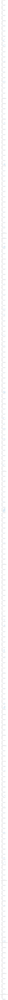

In [48]:

graph = sns.FacetGrid(df, row='Country')
graph.map(plt.plot, 'Year', 'GDP')
plt.title('Change in GDP over the years according to country wise')
plt.show()

In [ ]:
### Change in Population over the years according to country wise

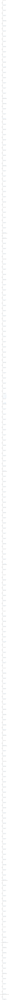

In [49]:

graph = sns.FacetGrid(df, row='Country')
graph.map(plt.plot, 'Year', 'Population')
plt.title('Change in Population over the years according to country wise')
plt.show()

### Distribution of Life Expentancy in each year for developed and developing countries

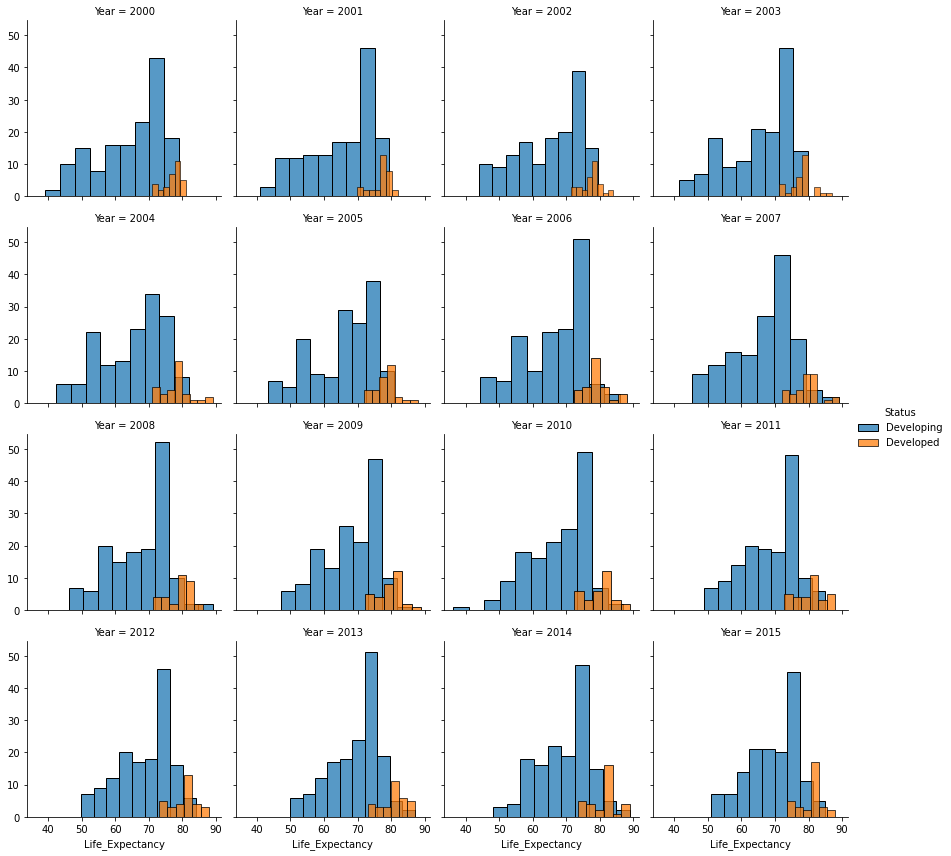

In [50]:
g = sns.FacetGrid(df, col='Year', hue='Status', col_wrap=4)
g.map(sns.histplot, 'Life_Expectancy')
g.add_legend()

plt.show()

#### Plotly

### Do densely populated countries tend to have lower life expectancy?

In [52]:
df_country_wise_avg_population = df.groupby('Country').agg({'Population': 'mean', 'Life_Expectancy': 'mean'}).reset_index()

plt.figure(figsize=(20,10))
px.scatter(x='Population', y='Life_Expectancy', data_frame=df_country_wise_avg_population, color='Country',
           size='Population',
          title="Life Expentancy according to country's average population")

<Figure size 1440x720 with 0 Axes>

### Which country has high average life expentancy rate from 2000-2015

In [53]:
df_year_life_exp = df.groupby(['Year', 'Country']).agg({'Life_Expectancy': 'mean'}).reset_index()

plt.figure(figsize=(20,10))
px.scatter(df_year_life_exp, x='Year', y='Life_Expectancy',color='Country',
           size='Life_Expectancy',
          title="Average Life Expentancy according to country over the years")

<Figure size 1440x720 with 0 Axes>

### Average Life Expentancy in year of 2000 for every country

In [132]:

plt.figure(figsize=(20,10))
px.scatter(df_year_life_exp.query("Year==2000"), x='Country', y='Life_Expectancy',color='Country',
           size='Life_Expectancy',
          title="Average Life Expentancy in 2000 according to country over the years")

<Figure size 1440x720 with 0 Axes>

### Average Life Expentancy in year of 2005 for every country

In [55]:

plt.figure(figsize=(20,10))
px.scatter(df_year_life_exp.query("Year==2005"), y='Country', x='Life_Expectancy',color='Country',
           size='Life_Expectancy',
          title="Average Life Expentancy in 2005 according to country over the years")

<Figure size 1440x720 with 0 Axes>

### Average Life Expentancy in year of 2010 for every country

In [56]:

plt.figure(figsize=(20,10))
px.scatter(df_year_life_exp.query("Year==2010"), y='Country', x='Life_Expectancy',color='Country',
           size='Life_Expectancy',
          title="Average Life Expentancy in 2010 according to country over the years")

<Figure size 1440x720 with 0 Axes>

### Average Life Expentancy in year of 2015for every country

In [57]:

plt.figure(figsize=(20,10))
px.scatter(df_year_life_exp.query("Year==2015"), y='Country', x='Life_Expectancy',color='Country',
           size='Life_Expectancy',
          title="Average Life Expentancy in 2015 according to country over the years")

<Figure size 1440x720 with 0 Axes>

### Ploty Express for Population per year vs Country

In [58]:

fig = px.scatter(df, 
                x='Year', 
                y='Population', 
                hover_name='Country', 
                color='Country',
                log_x=True,
                size='Year',
                size_max=60,
                title='A Plotly Express for Population-per-year vs Country')
fig.show()

### Drawing a Sunburst using Aduly mortality from 2000-2015

In [59]:
df_avg_adult_mortality = df.groupby(['Country', 'Year', 'Status']).agg({'Adult_Mortality': 'mean'}).reset_index()

data = dict(country = df_avg_adult_mortality['Country'].values.tolist(),
           Adult_Mortality = df_avg_adult_mortality['Adult_Mortality'].values.tolist())
px.sunburst(df_avg_adult_mortality, values='Adult_Mortality', color='Adult_Mortality', path=['Year'])

# average infant deaths from 2000-2015 for developing and developed countries

In [60]:

df_avg_infant_death = df.groupby(['Status', 'Year']).agg({'Infant_Deaths': 'mean'}).reset_index()

px.bar(df_avg_infant_death, x='Year', y='Infant_Deaths', 
        facet_col='Status', 
        title='Average infant deaths from 2000-2015 for developing and developed countries')

### Alcohol Consumption from 2000-2015 for developed and developing countires

In [61]:

df_avg_alcohol = df.groupby(['Status', 'Year']).agg({'Alcohol': 'mean'}).reset_index()

px.bar(df_avg_alcohol, x='Year', y='Alcohol', 
        facet_col='Status', 
        title='average alcohol consumption from 2000-2015 for developing and developed countries')

### % Expenditure from 2000-2015 for developed and developing countires

In [62]:

df_percentage_expenditure = df.groupby(['Status', 'Year']).agg({'Percentage_Exp': 'mean'}).reset_index()

px.bar(df_percentage_expenditure, x='Year', y='Percentage_Exp', 
        facet_col='Status', 
        title='Average % expenditure from 2000-2015 for developing and developed countries')

### Drawing a pie using Average Life Expectancy per Country

In [63]:

country = df['Country']
life_exp = df.groupby('Country')['Life_Expectancy'].mean()


# pull is given as a fraction of the pie radius
fig = go.Figure(data=[go.Pie(labels=country, values=life_exp, pull=[0, 0, 0.3, 0])])
fig.show()

### Country with average number of Hepatatis B patients over the years 

In [64]:

df_hepatatis_B = df.groupby(['Country', 'Year']).agg({'Hepatitis_B': 'mean'}).reset_index()

px.scatter(df_hepatatis_B, x='Year', y='Hepatitis_B', 
            color='Country', 
            size='Hepatitis_B', 
            title='Country with average number of Hepatatis B patients over the years ')

### Average Hepatatis B patients in developing and developed countires over the years

In [65]:

df_country_status_hepatatis = df.groupby(['Status', 'Year']).agg({'Hepatitis_B': 'mean'}).reset_index()

px.bar(df_country_status_hepatatis, x='Year', y='Hepatitis_B', 
        facet_col='Status', 
        title='Average Hepatatis B patients in developing and developed countires over the years')

### Country with average number of  Measles patients over the years 

In [134]:

df_Measles_B = df.groupby(['Country', 'Year']).agg({'Measles': 'mean'}).reset_index()

px.scatter(df_Measles_B, x='Year', y='Measles', 
            color='Country', 
            size='Measles', 
            title='Country with average number of Measles patients over the years ')

In [67]:

df_country_status_Measles = df.groupby(['Status', 'Year']).agg({'Measles': 'mean'}).reset_index()

px.bar(df_country_status_Measles, x='Year', y='Measles', 
        facet_col='Status', 
        title='Average Measles patients in developing and developed countires over the years')

### Country with average number of  Polio patients over the years 

In [68]:

df_polio = df.groupby(['Country', 'Year']).agg({'Polio': 'mean'}).reset_index()

px.scatter(df_polio, x='Year', y='Polio', color='Country', 
        size='Polio', 
        title='Country with average number of polio patients over the years ')

### Average Polio patients in developing and developed countires over the years

In [69]:

df_country_status_polio = df.groupby(['Status', 'Year']).agg({'Polio': 'mean'}).reset_index()

px.bar(df_country_status_polio, x='Year', y='Polio', 
        facet_col='Status', title='Average polio patients in developing and developed countires over the years')

In [70]:

df_Diphtheria = df.groupby(['Country', 'Year']).agg({'Diphtheria': 'mean'}).reset_index()

px.scatter(df_Diphtheria, x='Year', y='Diphtheria', 
        color='Country', 
        size='Diphtheria', 
        title='Country with average number of Diphtheria patients over the years ')

In [71]:

df_country_status_Diphtheria = df.groupby(['Status', 'Year']).agg({'Diphtheria': 'mean'}).reset_index()

px.bar(df_country_status_Diphtheria, x='Year', y='Diphtheria', 
        facet_col='Status', 
        title='Average Diphtheria patients in developing and developed countires over the years')

In [72]:
# Country with average number of  HIV/AIDS patients over the years 
df_HIV_AIDS = df.groupby(['Country', 'Year']).agg({'HIV/AIDS': 'mean'}).reset_index()

px.scatter(df_HIV_AIDS, x='Year', y='HIV/AIDS', 
        color='Country', 
        size='HIV/AIDS', 
        title='Country with average number of HIV/AIDS patients over the years ')

### Average HIV/AIDS patients in developing and developed countires over the years

In [73]:

df_country_status_HIV_AIDS = df.groupby(['Status', 'Year']).agg({'HIV/AIDS': 'mean'}).reset_index()

px.bar(df_country_status_HIV_AIDS, x='Year', y='HIV/AIDS', 
        facet_col='Status', 
        title='Average HIV/AIDS patients in developing and developed countires over the years')


### Impact of all disease on life expentancy over the years

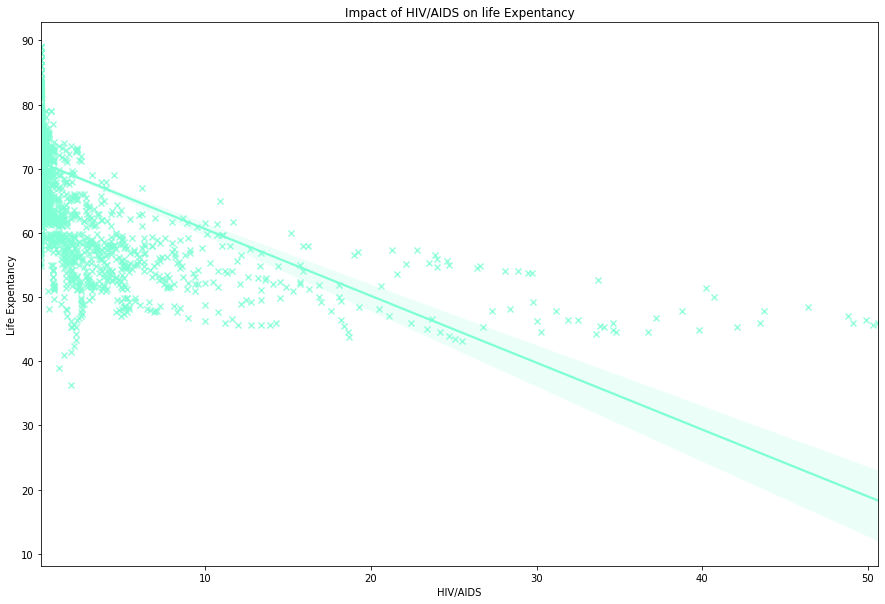

In [74]:
# HIV/AIDS
plt.figure(figsize=(15,10))
sns.regplot(data=df, x='HIV/AIDS', y='Life_Expectancy', marker='x', color='aquamarine')
plt.xlabel('HIV/AIDS')
plt.ylabel('Life Expentancy')
plt.title('Impact of HIV/AIDS on life Expentancy')
plt.show()

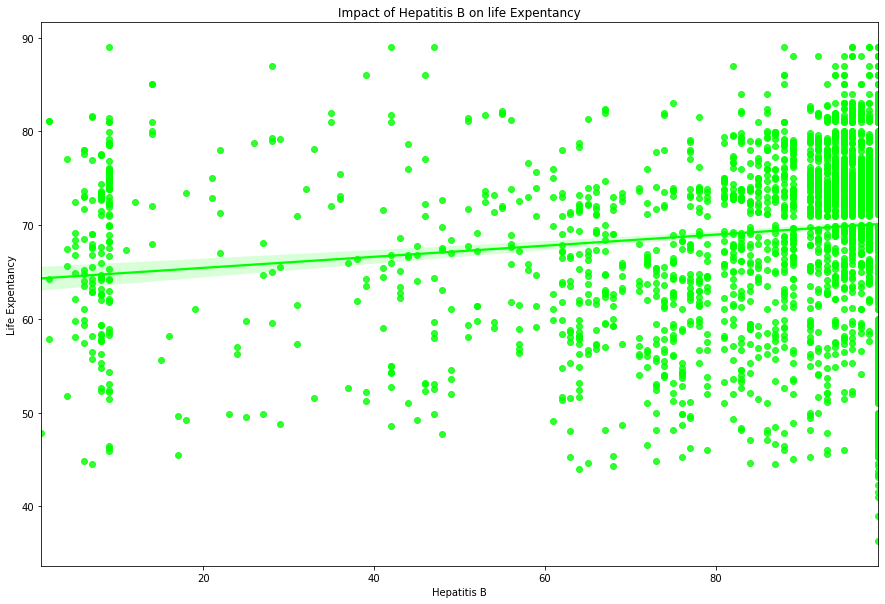

In [75]:
# Hepatitis B
plt.figure(figsize=(15,10))
sns.regplot(data=df, x='Hepatitis_B', y='Life_Expectancy', marker='o', color='lime')
plt.xlabel('Hepatitis B')
plt.ylabel('Life Expentancy')
plt.title('Impact of Hepatitis B on life Expentancy')
plt.show()

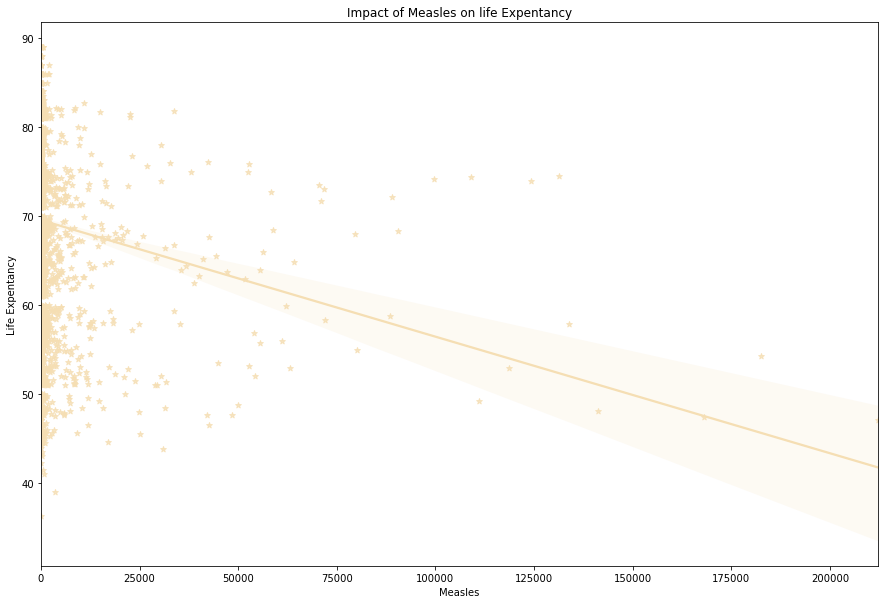

In [76]:
# Measles
plt.figure(figsize=(15,10))
sns.regplot(data=df, x='Measles', y='Life_Expectancy', marker='*', color='wheat')
plt.xlabel('Measles')
plt.ylabel('Life Expentancy')
plt.title('Impact of Measles on life Expentancy')
plt.show()

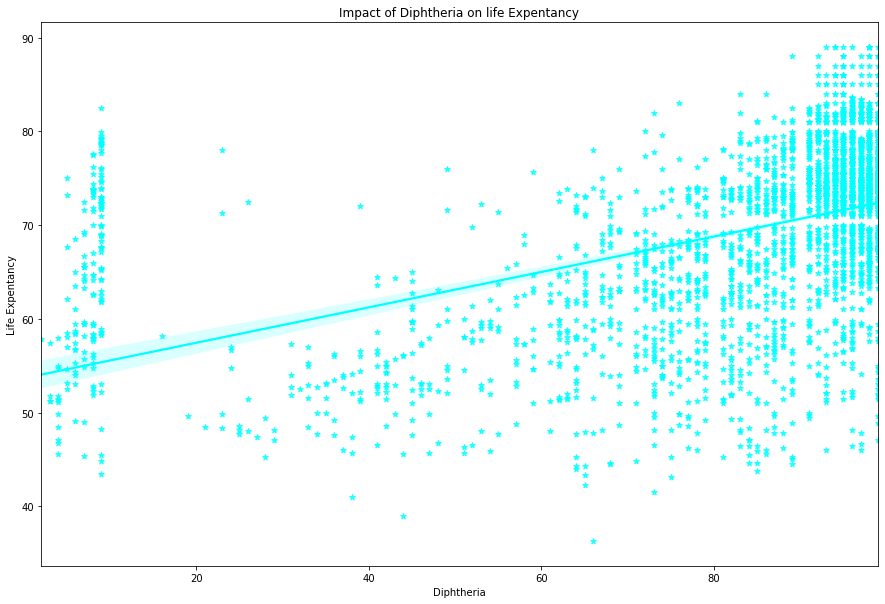

In [77]:
# Diphtheria
plt.figure(figsize=(15,10))
sns.regplot(data=df, x='Diphtheria', y='Life_Expectancy', marker='*', color='cyan')
plt.xlabel('Diphtheria')
plt.ylabel('Life Expentancy')
plt.title('Impact of Diphtheria on life Expentancy')
plt.show()

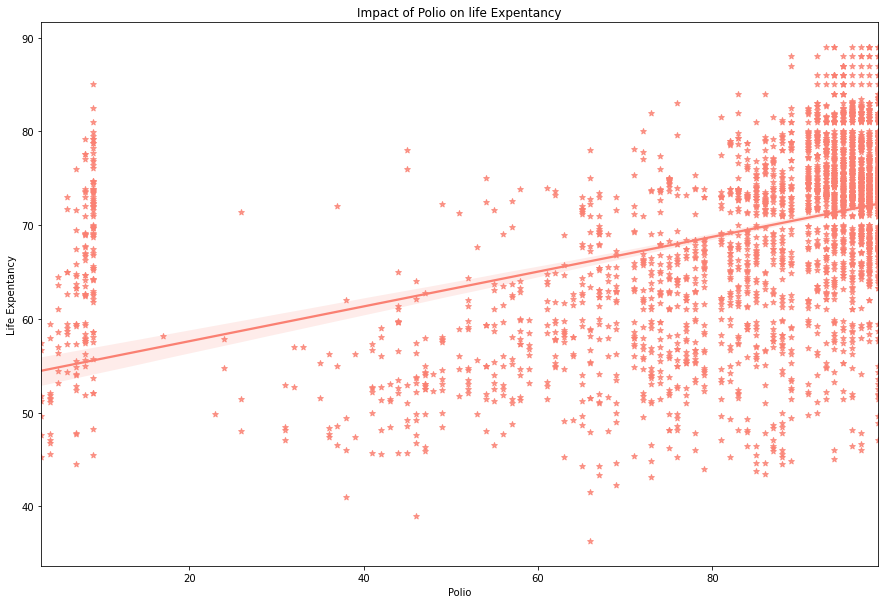

In [78]:
# Polio
plt.figure(figsize=(15,10))
sns.regplot(data=df, x='Polio', y='Life_Expectancy', marker='*', color='salmon')
plt.xlabel('Polio')
plt.ylabel('Life Expentancy')
plt.title('Impact of Polio on life Expentancy')
plt.show()

### Distribution of  Total Expenditure for developed and developing country countries

In [79]:

px.area(df, x='Year', y='Total_Expenditure', 
        color='Status', 
        line_group='Country', 
        title='Distribution of  Total Expenditure for developed and developing country countries')

In [80]:
# We will check distribution of  thinness 1-19 years for developed and developing country countries
px.area(df, x='Year', y='thinness_5_to_9_years', 
        color='Status', 
        line_group="Country", 
        title='Distribution of  thinness 5-9 years years for developed and developing country countries')

In [81]:
# We will check avergae Income composition of resources for developed and developing country countries
df_year_income_composition = df.groupby(['Year', 'Status']).agg({'Income_Comp_Of_Resources': 'mean'}).reset_index()

px.bar(df_year_income_composition, x='Year', y='Income_Comp_Of_Resources', 
        color='Status', 
        barmode='group', 
        title='Average of  Income composition of resources over years for developed and developing country countries')

### Schooling rate over the years for developing and developed countires.

In [82]:

df_schooling_over_year = df.groupby(['Year', 'Status']).agg({'Schooling': 'mean'}).reset_index()

px.sunburst(df_schooling_over_year, values='Schooling', 
            color='Schooling', 
            path=['Year', 'Status'], 
            title='Schooling rate over the years for developing and developed countires.')

### Should a country having a lower life expectancy value(<65) increase its healthcare expenditure in order to improve its average lifespan?

In [135]:


df_country_wise_expenditure_life_expentancy = df.groupby('Country').agg({'Life_Expectancy': 'mean', 'Percentage_Exp': 'mean'}).reset_index()

px.scatter(df_country_wise_expenditure_life_expentancy.query("Life_Expectancy <= 65"), 
        y='Percentage_Exp', 
        x='Life_Expectancy',
        color='Country',
        size='Percentage_Exp',
        title="Average Life Expentancy according to country having less than 65 life expetancy")


In [202]:
px.scatter(df_country_wise_expenditure_life_expentancy.query("Life_Expectancy > 65"), 
        y='Percentage_Exp', x='Life_Expectancy',
        color='Country',
        size='Percentage_Exp',
        title="Average Life Expentancy according to country having more than 65 life expetancy")

<p> As we can see from above two graphs, some countries with more than 65 life expentancy have less than 100 ependiture however as developed countries have more percentage for health expenditure,
their life expentancy seems to  be high, hence it is recommneded for countries to improve expenditure for health to increase life expentancy <p>

# Step 4.   Model Build

#### Designing a basic Linear Regression model with highly correlated parameters

In [85]:
corr = df.corr()
corr.head()

,Year,Life_Expectancy,Adult_Mortality,Infant_Deaths,Alcohol,Percentage_Exp,Hepatitis_B,Measles,BMI,Under_Five_Deaths,Polio,Total_Expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness_1_to_19_years,thinness_5_to_9_years,Income_Comp_Of_Resources,Schooling
Year,1.000000,0.171183,-0.083627,-0.037415,-0.155874,0.031400,-0.020203,-0.082493,0.108467,-0.042937,0.089941,0.028280,0.129905,-0.139741,0.090481,0.013908,-0.048051,-0.051075,0.186221,0.203336
Life_Expectancy,0.171183,1.000000,-0.696043,-0.196830,0.368554,0.381277,0.147037,-0.157817,0.544668,-0.222798,0.456296,0.206949,0.470119,-0.556745,0.428324,-0.030187,-0.459840,-0.454124,0.593499,0.709315
Adult_Mortality,-0.083627,-0.696043,1.000000,0.079620,-0.181667,-0.240916,-0.110453,0.031977,-0.372908,0.094990,-0.267695,-0.116409,-0.268046,0.523737,-0.279320,-0.003743,0.291685,0.296983,-0.385089,-0.427291
Infant_Deaths,-0.037415,-0.196830,0.079620,1.000000,-0.105467,-0.085612,-0.157669,0.501128,-0.224597,0.996629,-0.170924,-0.123241,-0.175399,0.025231,-0.101048,0.551762,0.462445,0.467987,-0.136524,-0.189125
Alcohol,-0.155874,0.368554,-0.181667,-0.105467,1.000000,0.353509,0.095270,-0.042617,0.278081,-0.102046,0.200213,0.321953,0.197299,-0.034495,0.302077,-0.023464,-0.384691,-0.374228,0.275061,0.483729


In [166]:
highly_correlated_paramters = [x for x in corr[corr['Life_Expectancy'] > 0.2].index.to_list() if x!= 'Life_Expectancy']
highly_correlated_paramters

['Alcohol',
 'Percentage_Exp',
 'BMI',
 'Polio',
 'Total_Expenditure',
 'Diphtheria',
 'GDP',
 'Income_Comp_Of_Resources',
 'Schooling']

In [167]:
features = df[highly_correlated_paramters].values
features

array([[1.00000000e-02, 7.12796236e+01, 1.91000000e+01, ...,
        5.84259210e+02, 4.79000000e-01, 1.01000000e+01],
       [1.00000000e-02, 7.35235817e+01, 1.86000000e+01, ...,
        6.12696514e+02, 4.76000000e-01, 1.00000000e+01],
       [1.00000000e-02, 7.32192427e+01, 1.81000000e+01, ...,
        6.31744976e+02, 4.70000000e-01, 9.90000000e+00],
       ...,
       [4.43000000e+00, 0.00000000e+00, 2.63000000e+01, ...,
        5.73483400e+01, 4.27000000e-01, 1.00000000e+01],
       [1.72000000e+00, 0.00000000e+00, 2.59000000e+01, ...,
        5.48587312e+02, 4.27000000e-01, 9.80000000e+00],
       [1.68000000e+00, 0.00000000e+00, 2.55000000e+01, ...,
        5.47358879e+02, 4.34000000e-01, 9.80000000e+00]])

In [168]:
target = df['Life_Expectancy'].values
target

array([65. , 59.9, 59.9, ..., 44.8, 45.3, 46. ])

In [169]:
# Importing libraries

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression

In [170]:
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.3, random_state=14)

In [171]:
lr = LinearRegression()
lr_model = lr.fit(X_train, y_train)
pred_y = lr_model.predict(X_test)

In [172]:
lr.coef_

array([7.60701622e-02, 1.26726211e-04, 9.67468626e-02, 3.84942018e-02,
       6.25189268e-02, 4.83413955e-02, 5.74539435e-05, 6.18702147e+00,
       1.04630933e+00])

In [173]:
lr.intercept_

40.990857313994

In [174]:
# Checking the accuracy
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error

In [175]:
MSE = mean_squared_error(y_test, pred_y)
R2_Score = r2_score(y_test, pred_y)
MAE = mean_absolute_error(y_test, pred_y)

In [176]:
print(f"Mean squared error - {MSE}\nR2 Score - {R2_Score}\nMean absolute error - {MAE}")

Mean squared error - 31.37087854486679
R2 Score - 0.6540604566415347
Mean absolute error - 4.212115294750827


In [177]:
# Performing standardscaler in features values as features vaalues on different scale

from sklearn.preprocessing import StandardScaler
stdScaler = StandardScaler()
std_fit = stdScaler.fit(X_train)
std_X_train = std_fit.transform(X_train)
std_X_train

array([[-7.68901858e-01,  2.28151780e+00,  1.43406835e+00, ...,
         6.27079156e+00,  1.00066521e+00,  4.45626872e-01],
       [-6.79426547e-01, -3.54512908e-01, -1.79877689e+00, ...,
        -4.50725059e-01, -4.13962943e-01, -1.19083917e+00],
       [-1.04726949e+00, -3.88361278e-03, -3.49226869e-01, ...,
        -1.97588568e-01, -1.96946125e-01, -1.60471662e-01],
       ...,
       [ 1.10013797e+00,  1.94439384e+00,  9.95716449e-01, ...,
         1.96146769e+00,  1.05692883e+00,  1.17294511e+00],
       [-5.87465811e-01, -3.63960030e-01, -9.86829628e-01, ...,
        -4.64492485e-01, -2.97416874e-01, -3.72606149e-01],
       [-7.29135053e-01, -6.25327236e-02,  1.05051044e+00, ...,
        -1.51856912e-01,  5.30462100e-01,  8.39590919e-01]])

In [178]:
std_X_test = std_fit.transform(X_test)

In [179]:
lr_std = LinearRegression()
lr_std_model = lr_std.fit(std_X_train, y_train)
std_pred_y = lr_std_model.predict(std_X_test)

In [180]:
lr_std_model.coef_

array([0.30606497, 0.24699638, 1.94221218, 0.90413568, 0.15463808,
       1.15868135, 0.7546921 , 1.53950814, 3.45260473])

In [181]:
lr_std_model.intercept_

69.08142023346305

In [182]:
MSE = mean_squared_error(y_test, std_pred_y)
R2_Score = r2_score(y_test, std_pred_y)
MAE = mean_absolute_error(y_test, std_pred_y)

In [183]:
print(f"Mean squared error - {MSE}\nR2 Score - {R2_Score}\nMean absolute error - {MAE}")

Mean squared error - 31.37087854486678
R2 Score - 0.6540604566415347
Mean absolute error - 4.212115294750825


In [184]:
# Using Polynomial features
from sklearn.preprocessing import PolynomialFeatures

In [185]:
poly = PolynomialFeatures(degree=3, include_bias=False)
poly_X_train_features = poly.fit_transform(std_X_train, y_train)

In [186]:
poly_X_test_features = poly.fit_transform(std_X_test, y_test)

In [187]:
poly_lr = LinearRegression()
poly_fit = poly_lr.fit(poly_X_train_features, y_train)
poly_pred_y = poly_fit.predict(poly_X_test_features)

In [188]:
MSE = mean_squared_error(y_test, poly_pred_y)
R2_Score = r2_score(y_test, poly_pred_y)
MAE = mean_absolute_error(y_test, poly_pred_y)

In [189]:
print(f"Mean squared error - {MSE}\nR2 Score - {R2_Score}\nMean absolute error - {MAE}")

Mean squared error - 16.94782987942477
R2 Score - 0.8131093293731008
Mean absolute error - 2.9479467328713542


In [190]:
# Using Ridge regularization

In [191]:
from sklearn.linear_model import Ridge
ridge = Ridge(alpha=1)
ridge_fit = ridge.fit(poly_X_train_features, y_train)
ridge_y_pred = ridge.predict(poly_X_test_features)

In [192]:
MSE = mean_squared_error(y_test, ridge_y_pred)
R2_Score = r2_score(y_test, ridge_y_pred)
MAE = mean_absolute_error(y_test, ridge_y_pred)

In [193]:
print(f"Mean squared error - {MSE}\nR2 Score - {R2_Score}\nMean absolute error - {MAE}")

Mean squared error - 15.927814774421858
R2 Score - 0.8243574542586942
Mean absolute error - 2.893217882985954


In [195]:
for i in [1, 5, 10, 20, 50, 100, 1000, 10000]:
    print(f"For alpha - {i}")
    ridge = Ridge(alpha=i)
    ridge_fit = ridge.fit(poly_X_train_features, y_train)
    ridge_y_pred = ridge.predict(poly_X_test_features)
    MSE = mean_squared_error(y_test, ridge_y_pred)
    R2_Score = r2_score(y_test, ridge_y_pred)
    MAE = mean_absolute_error(y_test, ridge_y_pred)
    print(f"Mean squared error - {MSE}\nR2 Score - {R2_Score}\nMean absolute error - {MAE}")
    print("*"*100)

For alpha - 1
Mean squared error - 15.927814774421858
R2 Score - 0.8243574542586942
Mean absolute error - 2.893217882985954
****************************************************************************************************
For alpha - 5
Mean squared error - 15.480673802135323
R2 Score - 0.8292882611389807
Mean absolute error - 2.88671515243458
****************************************************************************************************
For alpha - 10
Mean squared error - 15.496434272850715
R2 Score - 0.8291144639648085
Mean absolute error - 2.891977445093974
****************************************************************************************************
For alpha - 20
Mean squared error - 15.811656745763248
R2 Score - 0.825638376478775
Mean absolute error - 2.9109605098699194
****************************************************************************************************
For alpha - 50
Mean squared error - 16.829068006034
R2 Score - 0.814418965256917
Mean absolute erro